## SAR images denoise with the trained model. 
Here the images are pre-processed with SNAP software: 
orbit file corrected, radiometrically calibrated and pixel amplitude adjusted to 0-255

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from tifffile import tifffile
from PIL import Image
import os
from datasets import Dataset
from sar_denoise.dataset_transforms import make_transform_images, normalize_u8, to_u8, to_log_u8 
import torch
from diffusers import DDPMScheduler, UNet2DModel
from torchvision import transforms
from sar_denoise.DDPMSpecklePipeline import DDPMSpecklePipeline
from sar_denoise.dataset_transforms import make_transform_images 
from datasets import load_dataset
from tqdm import tqdm
from pathlib import Path
from einops import rearrange

In [2]:
# SAR files after orbital correction and radiometrically callibrated, db scaled to 0-255
dir_out_512_cal = Path('/data/sar/sar_data/sar_tiles_png_cal_512/')
sar_orb_cal = Path('/data/sar/sar_data/SAR_Orb_Cal')

# These are orbit corrected, calibrated and db scaled to 0-255 range files pre-processed with SNAP:
f1_db = 'f0658ae_f6f2_GRDH_Orb_Cal_Sigma0_VH_db.tif'
f1_vh_db = 'f0658ae_f6f2_GRDH_Orb_Cal_Sigma0_VH_db.png'
f1_vv_db = 'f0658ae_f6f2_GRDH_Orb_Cal_Sigma0_VV_db.png'

In [6]:
Image.MAX_IMAGE_PIXELS = None
imvh = np.array(Image.open(os.path.join(sar_orb_cal, f1_vh_db)), dtype = np.uint8)
imvv = np.array(Image.open(os.path.join(sar_orb_cal, f1_vv_db)), dtype = np.uint8)

In [7]:
print(imvh.shape, imvv.shape, np.shape(imvh)) 
# (16743, 25586, 4) (16743, 25586, 4) (16743, 25586, 4)

(16743, 25586, 4) (16743, 25586, 4) (16743, 25586, 4)


The orbit corrected, calibrated and  db corrected images from SNAP have 4 bands:
the first 3 bands seem to be identical (the pixel difference is all 0 )
the 4th band is different, not amplitude adjusted and highly skewed to 255

This is the decibel conversion used for amplitude adjustment to 0-255 according to SNAP docummnetation:
Sigma0_VH==0 ? 0 : 10 * log10(abs(Sigma0_VH))

In [8]:
# print(np.min(imvv[:,:,0]), np.max(imvv[:,:,0]), np.mean(imvv[:,:,0]), np.median(imvv[:,:,0]))
# print(np.min(imvv[:,:,1]), np.max(imvv[:,:,1]), np.mean(imvv[:,:,1]), np.median(imvv[:,:,1]))
# print(np.min(imvv[:,:,2]), np.max(imvv[:,:,2]), np.mean(imvv[:,:,2]), np.median(imvv[:,:,2]))
print(np.min(imvv[:,:,3]), np.max(imvv[:,:,3]), np.mean(imvv[:,:,3]), np.median(imvv[:,:,3]))

# print(np.min(imvh[:,:,0]), np.max(imvh[:,:,0]), np.mean(imvh[:,:,0]), np.median(imvh[:,:,0]))
# print(np.min(imvh[:,:,1]), np.max(imvh[:,:,1]), np.mean(imvh[:,:,1]), np.median(imvh[:,:,1]))
# print(np.min(imvh[:,:,2]), np.max(imvh[:,:,2]), np.mean(imvh[:,:,2]), np.median(imvh[:,:,2]))
print(np.min(imvh[:,:,3]), np.max(imvh[:,:,3]), np.mean(imvh[:,:,3]), np.median(imvh[:,:,3]))

0 255 249.27850524329673 255.0
0 255 249.27850702906773 255.0


In [9]:
# All pixel differences between bands 0-2 are all zero except for band 3:
print(np.max(imvv[:,:,0]-imvv[:,:,1]), np.max(imvv[:,:,0]-imvv[:,:,2]), np.max(imvv[:,:,1]-imvv[:,:,2]), np.max(imvv[:,:,0]-imvv[:,:,3])) # 0 0 0 255

0 0 0 255


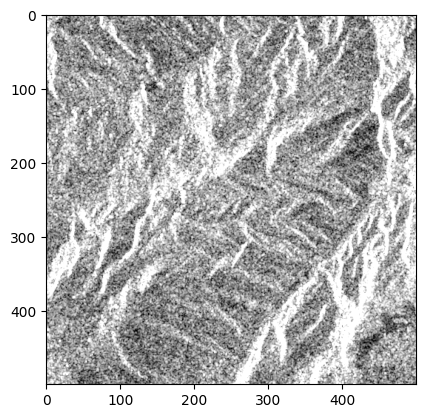

In [10]:
plt.imshow(imvv[3000:3500, 4000:4500, 0], cmap='gray')

In [11]:
# # show 4 bands on VV polarization image:
# fig, axs = plt.subplots(2, 2, figsize=(10, 10))
# axs[0, 0].imshow(imvv[3000:3500, 4000:4500, 0], cmap='gray')
# axs[0, 1].imshow(imvv[3000:3500, 4000:4500, 1], cmap='gray')
# axs[1, 0].imshow(imvv[3000:3500, 4000:4500, 2], cmap='gray')
# axs[1, 1].imshow(imvv[3000:3500, 4000:4500, 3], cmap='gray')
# #axs[1, 1].imshow(20*np.log10(np.abs(imvv[3000:3500, 4000:4500, 3])), cmap='gray')

In [12]:
# # show 4 bands on VH polarization image:
# fig, axs = plt.subplots(2, 2, figsize=(10, 10))
# axs[0, 0].imshow(imvh[3000:3500, 4000:4500, 0], cmap='gray')
# axs[0, 1].imshow(imvh[3000:3500, 4000:4500, 1], cmap='gray')
# axs[1, 0].imshow(imvh[3000:3500, 4000:4500, 2], cmap='gray')
# axs[1, 1].imshow(imvh[3000:3500, 4000:4500, 3], cmap='gray')

### Splitting calibrated SAR files to tiles

In [13]:
def split_images_to_tiles(filename, dir_in, dir_out, d):
    name, ext = os.path.splitext(filename)
    img = np.array(Image.open(os.path.join(dir_in, filename)), dtype = np.uint8)
    w, h = np.shape(img)[0], np.shape(imvh)[1]
    ext = '.png'

    # Here I cropped the edge of the image (first 1000 pixels), because it contained no data, all black pixels
    # Since the images are large, 16696 by 25771 size, the cropping did not remove much data
    # In the future it would be good to improve this to automatically detect where the data starts
    for i in range(1000, w, d):
        for j in range(1000, h ,d): 
            out = os.path.join(dir_out, f'{name}_{i}_{j}{ext}')
            if i+d<=w or j+d<=h:
                tile = img[i:i+d,j:j+d, 0]
                tile = Image.fromarray(tile).convert("L").save(out)
            
    return None

In [14]:
# split_images_to_tiles(f1_vv_db, sar_orb_cal, dir_out_512_cal, 512)

### Loading calibrated and db corrected tiles as a dataset:

In [3]:
full_dataset = load_dataset(os.path.join(dir_out_512_cal))


Resolving data files:   0%|          | 0/1518 [00:00<?, ?it/s]

In [4]:
unet = UNet2DModel.from_pretrained("/data/diffden/exp_speckle_1_output/unet")
# use torch.compile on this

noise_scheduler = DDPMScheduler(num_train_timesteps=1000, beta_schedule="linear")

# TODO can just load pipeline instead of loading unet?
pipeline = DDPMSpecklePipeline(
    unet=unet,
    scheduler=noise_scheduler,
).to("cuda")

device = pipeline.device

In [5]:
# Preprocessing the datasets and DataLoaders creation.

def xf(image):
    # l_image = Image.fromarray(image).convert("L")
    # image will have values in range [0-255]
    tensor_image = torch.Tensor(np.array(image)).unsqueeze(0)
    # normalize to [-0.5, 0.5]
    return (tensor_image - 127.5) / 255.
    

def transform_images(examples):
    # images = [augmentations(image.convert("L")) for image in examples["image"]] # Images are already 'L' mode
    images = [xf(image) for image in examples["image"]]
    return {"input": images}

full_dataset.set_transform(transform_images)

In [6]:
# plt.imshow(full_dataset['train'][33]['input'])
full_dataset['train'][33]['input'].unsqueeze(0).shape

torch.Size([1, 1, 512, 512])

In [7]:
image_indices = (np.r_[:16] * 17 + 31).astype(int).tolist()
dataset = torch.utils.data.Subset(full_dataset["train"], image_indices)
dataloader = torch.utils.data.DataLoader(dataset, batch_size=16, shuffle=False)

In [8]:
def normalize_image(image):
    return (image - image.min()) / (image.max() - image.min())

def plot_image_batch(images):
   # note: it might be better to normalize each image in the batch individually
   images_np = (normalize_image(images) * 255).float().round().cpu().squeeze(1).numpy().astype(np.uint8) 

   fig, axs = plt.subplots(4, 4, figsize=(20, 20))
   for i, ax in enumerate(axs.flat):
       ax.imshow(images_np[i], cmap="gray")
       ax.axis("off")

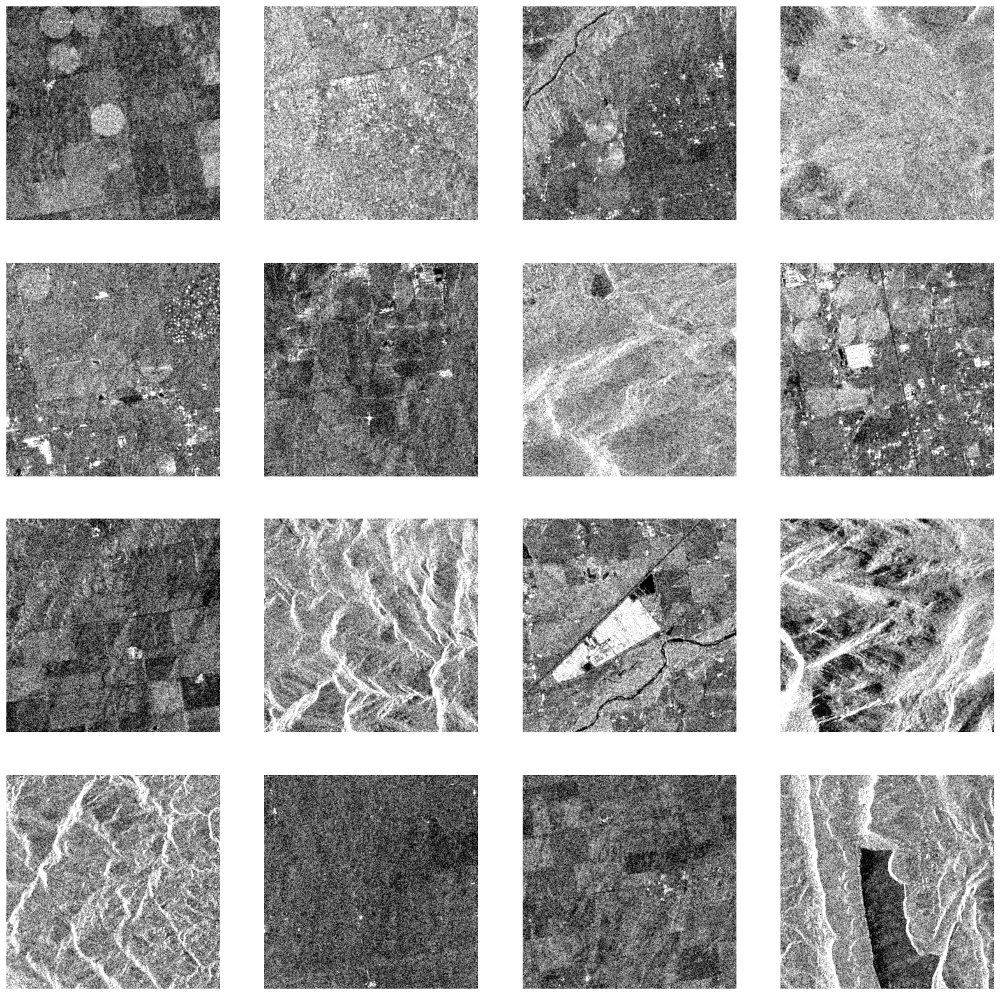

In [9]:
val_batch = next(iter(dataloader))
val_images = val_batch["input"].to(device)

plot_image_batch(val_images)

In [10]:
val_images.shape

torch.Size([16, 1, 512, 512])

In [11]:
val_images_uf64 = torch.nn.functional.unfold(val_images, 64, stride=32)
val_images_uf64 = rearrange(val_images_uf64, "b (c h w) p -> p b c h w", c=1, h=64, w=64)

val_images_uf64.shape

torch.Size([225, 16, 1, 64, 64])

## SAR images despeckling with 100 inference steps:

In [12]:
# # this runs for a very long time.

# generator = torch.Generator(device=pipeline.device).manual_seed(0)

# denoised_images_uf64_100steps = torch.zeros_like(val_images_uf64) 

# for i in tqdm(range(val_images_uf64.shape[0]), colour="blue", desc="patch"):
#     pipeline.progress_bar = lambda _: _
#     denoised_images_uf64_100steps[i] = pipeline(val_images_uf64[i], generator=generator, num_inference_steps=100, return_tensor=True)


In [13]:
# denoise_SAR_cal_db_100steps = torch.nn.functional.fold(rearrange(denoised_images_uf64_100steps, "p b c h w -> b (c h w) p"), output_size=512, kernel_size=64, stride=32)

In [14]:
# torch.save(denoise_SAR_cal_db_100steps, '/data/sar/denoise_SAR_cal_db_100steps')
denoise_SAR_cal_db_100steps = torch.load('/data/sar/denoise_SAR_cal_db_100steps')

In [15]:
# plot_image_batch(denoise_SAR_cal_db_100steps)

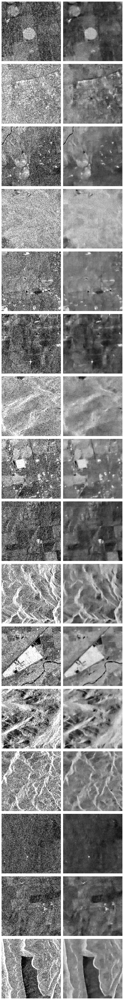

In [18]:
valid_slice = slice(64, 512-64)
valid_region = tuple(valid_slice for _ in range(2))

def f(image):
    image = image.cpu().squeeze(0)
    image = image[valid_region]
    image = normalize_image(image)
    #image = normalize_image(np.log(image + 1e-6))
    return image

indices = list(range(len(val_images)))
# plot pairs of images next to each other
fig, ax = plt.subplots(len(indices), 2, figsize=(8, len(indices)*4))
for i, idx in enumerate(indices):
    ax[i, 0].imshow(f(val_images[idx]), cmap="gray")
    ax[i, 0].axis("off")
    ax[i, 1].imshow(f(denoise_SAR_cal_db_100steps[idx]), cmap="gray")
    ax[i, 1].axis("off")
    fig.tight_layout()

In [27]:
# ### Saving images for the report, image display is off:

# valid_slice = slice(64, 512-64)
# valid_region = tuple(valid_slice for _ in range(2))

# def f(image):
#     image = image.cpu().squeeze(0)
#     image = image[valid_region]
#     image = normalize_image(image)
#     #image = normalize_image(np.log(image + 1e-6))
#     return image

# indices = list(range(len(val_images)))
# # plot pairs of images next to each other
# fig, ax = plt.subplots(1, 2, figsize=(10, 4))
# for i, idx in enumerate(indices):
#     plt.ioff()
#     ax[0].imshow(f(val_images[idx]), cmap="gray")
#     ax[0].axis("off")
#     ax[1].imshow(f(denoise_images_100steps[idx]), cmap="gray")
#     ax[1].axis("off")
#     plt.tight_layout()
#     plt.savefig('/data/images/sar_despeckling' + str(i) +  '.png', dpi=300)
    
#     plt.ion()



## SAR images despeckling with 1000 inference steps:

In [28]:
# This runs for a very long time. The output is saved below.

# generator = torch.Generator(device=pipeline.device).manual_seed(0)

# denoised_images_uf64_1000steps = torch.zeros_like(val_images_uf64) 

# for i in tqdm(range(val_images_uf64.shape[0]), colour="blue", desc="patch"):
#     pipeline.progress_bar = lambda _: _
#     denoised_images_uf64_1000steps[i] = pipeline(val_images_uf64[i], generator=generator, num_inference_steps=1000, return_tensor=True)


In [29]:
# denoise_SAR_cal_db_1000steps = torch.nn.functional.fold(rearrange(denoised_images_uf64_1000steps, "p b c h w -> b (c h w) p"), output_size=512, kernel_size=64, stride=32)

In [19]:
# torch.save(denoise_SAR_cal_db_1000steps, '/data/sar/denoise_SAR_cal_db_1000steps')
denoise_SAR_cal_db_1000steps = torch.load('/data/sar/denoise_SAR_cal_db_1000steps')

In [20]:
# plot_image_batch(denoise_SAR_cal_db_1000steps)

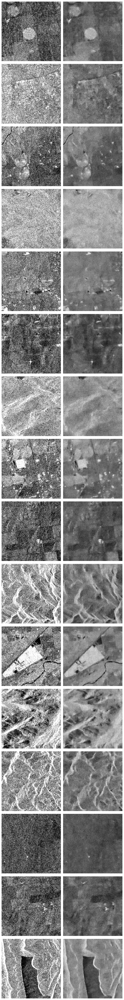

In [21]:
valid_slice = slice(64, 512-64)
valid_region = tuple(valid_slice for _ in range(2))

def f(image):
    image = image.cpu().squeeze(0)
    image = image[valid_region]
    image = normalize_image(image)
    #image = normalize_image(np.log(image + 1e-6))
    return image

indices = list(range(len(val_images)))
# plot pairs of images next to each other
fig, ax = plt.subplots(len(indices), 2, figsize=(8, len(indices)*4))
for i, idx in enumerate(indices):
    ax[i, 0].imshow(f(val_images[idx]), cmap="gray")
    ax[i, 0].axis("off")
    ax[i, 1].imshow(f(denoise_SAR_cal_db_1000steps[idx]), cmap="gray")
    ax[i, 1].axis("off")
    plt.tight_layout()


The despeckling denoise on SAR images looks great, perhaps even too strong, some of finer details look a little washed out. It is worth checking if is not doing too much. Also, after preprocessing and db amplitude correction the patch artifacts are a lot more visible. Next I will apply padding and tapering to reduce patches artifacts. 